# Домашняя работа 1
## В данном задании мы будем сжимать звуковую дорожку при помощи алгоритма PCA

In [ ]:
# Понадобится для чтения и записи аудио файлов
from scipy.io import wavfile

# Это нужно для проигрывания аудио файлов прямо в блокноте
from IPython.display import Audio
import IPython.display as ipd
# А это набор для этого задания
import numpy as np
import matplotlib.pyplot as plt
from sklearn.decomposition import PCA

In [ ]:
# Скачаем данные
! wget https://www.dropbox.com/s/p5147nr8mzemxnr/Beethoven_Violin_Sonata_Op_96_first_movement_bars_1-22.wav

--2023-02-01 12:19:37--  https://www.dropbox.com/s/p5147nr8mzemxnr/Beethoven_Violin_Sonata_Op_96_first_movement_bars_1-22.wav
Resolving www.dropbox.com (www.dropbox.com)... 162.125.65.18, 2620:100:601a:18::a27d:712
Connecting to www.dropbox.com (www.dropbox.com)|162.125.65.18|:443... connected.
HTTP request sent, awaiting response... 302 Found
Location: /s/raw/p5147nr8mzemxnr/Beethoven_Violin_Sonata_Op_96_first_movement_bars_1-22.wav [following]
--2023-02-01 12:19:38--  https://www.dropbox.com/s/raw/p5147nr8mzemxnr/Beethoven_Violin_Sonata_Op_96_first_movement_bars_1-22.wav
Reusing existing connection to www.dropbox.com:443.
HTTP request sent, awaiting response... 302 Found
Location: https://uc1836cea83354a601b040c65ec9.dl.dropboxusercontent.com/cd/0/inline/B1oD7wOTSXWfiXSYy5uysoO16x_MEvpvlD7FEFWcut629DEMjRKO62tmYoS_OqpXAl0S22CVJYIdc8BlMI6wrcfgnEONiL3AsSn_ydUE4vwqE8j-30TQBP9ZdHkVUw9_D9ndspDlOakFAuqIDKN8RJV9cfbXGVDljZtIuFMUGT2Lnw/file# [following]
--2023-02-01 12:19:38--  https://uc1836c

In [ ]:
# Прочитаем аудио дорожку при помощи wavfile
samplerate, data = wavfile.read('Beethoven_Violin_Sonata_Op_96_first_movement_bars_1-22.wav')

`samplerate` есть частота дискретизации - стандартное для аудио значние -- 44100 Гц.

NOTE: **Частота дискретизации** говорит о том, сколько последовательных элементов массива с сигналом кодируют звук длительностью 1 секунда.

Подробнее о кодировании звука [тут](https://ru.wikipedia.org/wiki/Кодирование_звуковой_информации).

In [ ]:
# Посмотрим какая у нас частота диспретезации
print(samplerate)

44100


In [ ]:
# Если поделить длину массива сигнала на samplerate, получится длительность аудиодорожки в секундах

print((len(data) / samplerate))

# 45 секунд - похоже на правду:)

45.139591836734695


In [ ]:
# Заметим, что звук - стерео, так как сигнал кодируется двумя каналами (для левого и правого динамика):

print(data.shape)

(1990656, 2)


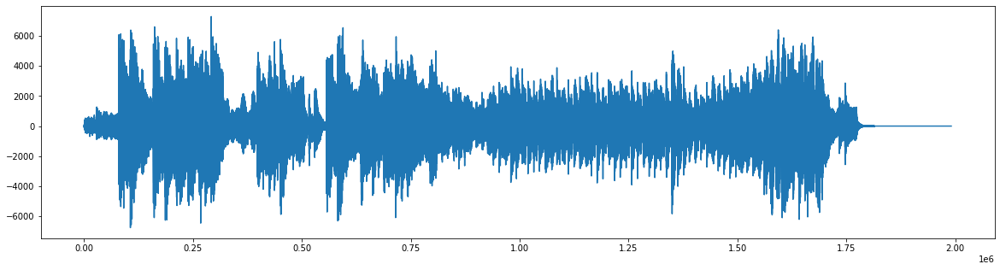

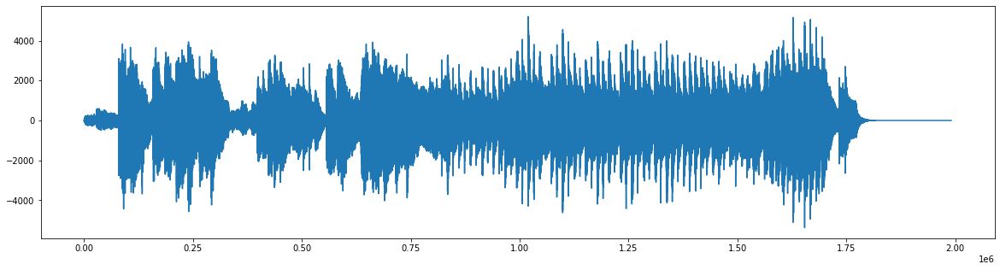

In [ ]:
# Отрисуем сигналы в обоих каналах

# Канал 1
plt.figure(figsize=(20,5))
plt.plot(data[:,0])
plt.show()

# Канал 2
plt.figure(figsize=(20,5))
plt.plot(data[:,1])
plt.show()

In [ ]:
# Усредним каналы, и получим моно звук, с которым будет проще работать

mono_sound = np.mean(data, axis=1)
print(mono_sound.shape)

(1990656,)


In [ ]:
# Давайте послушаем наконец, что же мы будем сжимать:)

Audio(mono_sound, rate = samplerate)

In [ ]:
# Для удобства - обрежем массив с сигналом так, чтобы его было удобнее делить на равные части, датасет из которых и необходимо будет сжать известными вам методами.
# На самом деле способ очень похож на тот, которым мы сжимали картинку, деля её на прямоугольные подкартинки, только здесь задача еще проще)

mono_sound_to_cut = mono_sound[:1990000]

In [ ]:
# Проверим, что наш звук теперь это просто вектор числел

print(mono_sound_to_cut.shape)

(1990000,)


#### Задание 1:

**Подсказка:** В это задании нужно всего лишь вспомнить как пользоваться методом `.reshape()`


1. Разделите сигнал на равные части (длину каждой части возьмите равной 1000) и соберите из них "датасет", который будет представлять из себя двухменый массив - "матрицу", в которой каждая часть сигнала длины 1000 находится в отдельной строке).

    То есть первая часть содержит первые 1000 чисел сигнала и находится в первой строке матрицы, вторая часть следующие 1000 чисел сигнала и находится во второй строке матрицы и так далее.

    Это также как мы делали с кусочками картинки и получали матрицу размера `(24, 1152000)`!

In [ ]:
matrix_sound = mono_sound_to_cut.reshape(1990, 1000)

In [ ]:
matrix_sound.shape

(1990, 1000)

2. Напишите функцию, которая будет переводить вашу "матрицу" обратно в звуковой сигнал, то есть разворачивать данные обратно из матрицы размера `(число объектов, 1000)` в вектор длины `(число объектов * 1000)`. Проверьте, что все работает верно, путем воспроизведения "востановленного" сигнала -- он должен совпасть в точности с изначальным (ведь им на самом деле и является).

In [ ]:
from scipy.ndimage import gaussian_filter1d
def num_to_sound(matrix, to_shape, freq, filter = False):
  matrix = matrix.reshape(to_shape)
  if filter:
    return Audio(gaussian_filter1d(matrix, 2), rate = freq)
  else:
   return Audio(matrix, rate = freq)

In [ ]:
num_to_sound(matrix_sound, mono_sound_to_cut.shape, samplerate)

#### Задание 2

Подсказка: код этого пункта практически полностью совпадает с кодом, который мы использовали на семинаре.

1. Выполните PCA преобразование нашей матрицы, и получите данные, сжатые в пространство меньшей размерности.

    На этом этапе у нас есть наш "датасет" с 1000 "признаками" и мы хотим уменьшить число "признаков" путем применения метода PCA. Число компонент предлагается выбрать вам, но для начала не стоит брать слишком маленькое число, чтобы потом было проще понять, в случае плохого результата -- компонент оказалось недостаточно или вы где-то ошиблись:)


In [ ]:
def transform(matrix, n_components):
  pca = PCA(n_components=n_components)
  return pca.fit_transform(matrix)

In [ ]:
params = [matrix_sound, 400]

In [ ]:
transform(*params).shape

(1990, 400)


2. Постройте сами две главные компоненты в наглядной форме. Сделайте выводы исходя из их вида.

    То есть необходимо применить метод PCA к нашей матрице с числом компонент, равным 2 (тем самым получив датасет с 2 "признаками"). Это позволит нам отрисовать данные на плоскости, чтобы попытаться уловить зависимости.

In [ ]:
params[1] = 2
transform(*params)

array([[ -20.43605326,  -21.56030846],
       [ -74.80041704,    4.70152587],
       [-107.54866274,  112.94160404],
       ...,
       [ -13.77118328,  -80.02902577],
       [ -13.77118328,  -80.02902577],
       [ -13.77118328,  -80.02902577]])

In [ ]:
print('Минимальное значение в матрице:', np.min(transform(*params)))
print('Максимальное значение в матрице:', np.max(transform(*params)))
print('Cреднее значение в матрице:', np.mean(transform(*params)))

Минимальное значение в матрице: -33227.01690681414
Максимальное значение в матрице: 35127.250779525166
Cреднее значение в матрице: -2.7421950807223966e-14


Вывод: данные слишком сильно пережаты и некоторые параметры принимают слишком высокие\низкие значения.

3. Постройте scatter plot датасета в пространстве первых двух компонент, а третью используйте как цвет.
    То есть необходимо применить метод PCA уже с 3 компонентами и нарисовать опять точки, только передав третью компоненту в качестве цвета. (мы также делали на семинаре с картинкой)

In [ ]:
params[1] = 3
pca_3 = transform(*params)

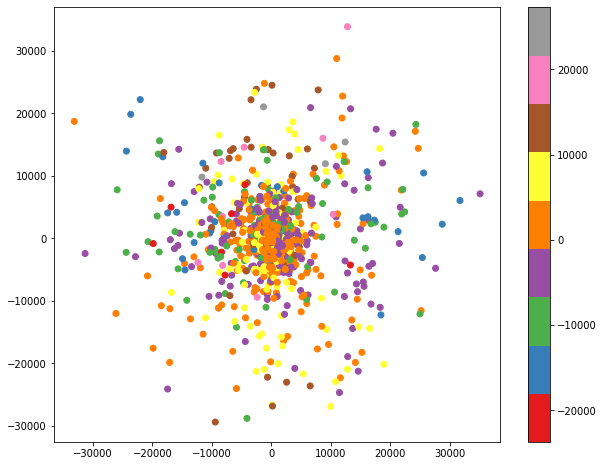

In [ ]:
plt.figure(figsize=(10,8), facecolor='white')

plt.scatter(
    pca_3[:, 0],
     pca_3[:,1],
      c = pca_3[:,2],
       cmap='Set1')

plt.colorbar()
plt.show()

#### Задание 3

Нам осталось заняться непосредственно "сжатием" звука и проверкой правильности наших действий.

1. Выполните обратное PCA преобразование сжатых данных и получите "матрицу" с сжатым звуком.

    Воспользуйтесь обратным преобразованием PCA (inverse_transform), чтобы из матрицы размера `(число объектов, число компонент)` перейти в матрицу размера `(число объектов, 1000)`.

In [ ]:
params.append(mono_sound_to_cut.shape)
params.append(samplerate)

In [ ]:
params

[array([[  0. ,  -1. ,  -1. , ...,  88.5,  58.5,  18. ],
        [-25.5, -61.5, -81.5, ...,  30.5, -20.5, -53. ],
        [-67.5, -65.5, -50. , ..., 118.5, 118.5,  86.5],
        ...,
        [  0. ,   0. ,   0. , ...,   0. ,   0. ,   0. ],
        [  0. ,   0. ,   0. , ...,   0. ,   0. ,   0. ],
        [  0. ,   0. ,   0. , ...,   0. ,   0. ,   0. ]]),
 3,
 (1990000,),
 44100]

In [ ]:
def compression(matrix, n_components, to_shape, freq, show_matrix = False, filter = False):
  pca = PCA(n_components=n_components)
  Y = pca.fit_transform(matrix)
  pca_transform = pca.inverse_transform(Y)
  if show_matrix:
    return pca_transform
  else:
    return num_to_sound(pca_transform, to_shape, freq, filter)

In [ ]:
compression(*params, True).shape

(1990, 1000)

2. Преобразуйте "матрицу", получившуюся обратным преобразованием, в сигнал (одномерный массив, наш "сжатый" монозвук), и послушайте результат `(Audio(YOUR_RESULT, rate = samplerate)`.

    Воспользуйтесь функцией, которую написали в первом задании, чтобы преобразовать матрицу с "сжатым" звуком (размер после обратного преобразования должен быть такой же, как и у оригинальной матрицы) в вектор-сигнал, который уже можно будет прослушать. Если звук похож на оригинал, то вы все сделали правильно! 

In [ ]:
params[1] = 600
compression(*params)

3. Исследуйте зависимость качества звука от числа компонент. Подберите "на слух" минимальное число компонент, при котором звук практически не отличается от оригинала.

    Добавьте в ячейки два варианта звуковой дорожки -- оригинальную и выбранную вами. Укажите какое число компонент вы оставили.

Подсказка! попробуйте отфильтровать сигнал с помощью функции `gaussian_filter1d` из `scipy.ndimage`. Это поможет убрать неприятный дробовой шум при сильном сжатии

Пример кода для фильтрации - `Audio(gaussian_filter1d(mono_sound_compressed, 2), rate = samplerate)`

In [ ]:
Audio(mono_sound, rate = samplerate)

In [ ]:
params[1] = 300
compression(*params)

In [ ]:
compression(*params, filter = True)

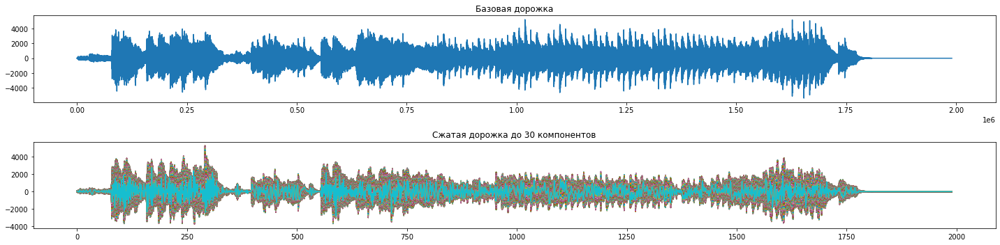

In [ ]:
params[1] = 30
plt.figure(figsize=(20,5), facecolor = 'white')

plt.subplot(2,1,1)
plt.plot(data[:,1])
plt.title('Базовая дорожка')

plt.subplot(2,1,2)
plt.plot(compression(*params,True))
plt.title('Сжатая дорожка до 30 компонентов')

plt.tight_layout()
plt.show()


3.1   Ответьте на вопросы: 
- Количество компонент, которое вы выбрали это много или мало? 
- Как сильно можно сжать звук таким образом? 
- А если нам дадут другую звуковую дорожку, нам надо сделать то же самое, чтобы сжать звук, как автоматически подобрать число компонент и возможно ли это?




- Число компонент равное 300 примерно похоже на оригинал.
- Удалось сжать звук на 70%. Отфильтрованная дорожка на слух различалась с бOльшим числом компонент.
- Чтобы подобрать автоматически количество компонентов, необходимо масштабировать наши данные от 0 до 1.

In [ ]:
from sklearn.preprocessing import MinMaxScaler
scaler = MinMaxScaler()
matrix_sound_rescaled = scaler.fit_transform(matrix_sound)

In [ ]:
rescaled_dict_matrix = []

In [ ]:
rescaled_dict_matrix.append(scaler.fit_transform(mono_sound_to_cut.reshape(1990, 1000)))
rescaled_dict_matrix.append(scaler.fit_transform(mono_sound_to_cut.reshape(3980, 500)))
rescaled_dict_matrix.append(scaler.fit_transform(mono_sound_to_cut.reshape(7960, 250)))

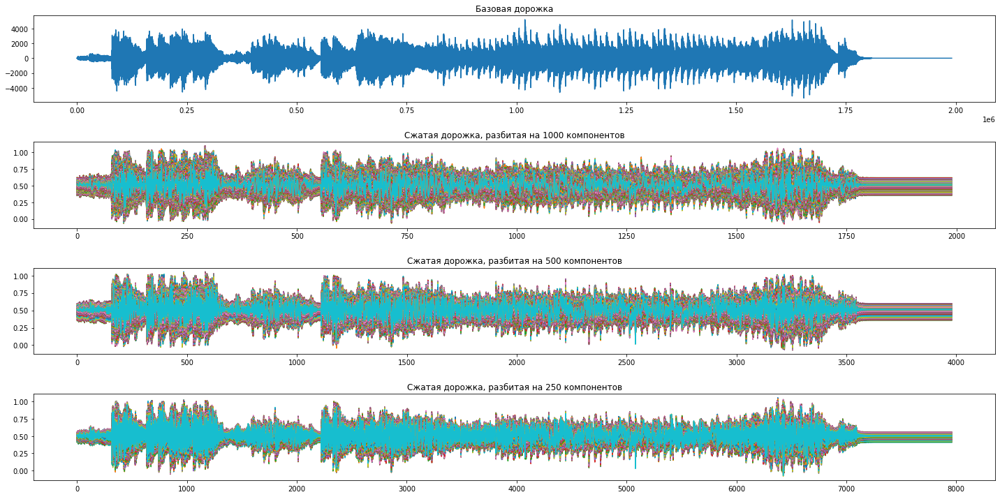

In [ ]:
params[1] = 0.95
plt.figure(figsize=(20,10), facecolor = 'white')

plt.subplot(4,1,1)
plt.plot(data[:,1])
plt.title('Базовая дорожка')

for i in range(len(rescaled_dict_matrix)):

  params[0] = rescaled_dict_matrix[i]
  plt.subplot(4,1,2 + i)
  plt.plot(compression(*params,True))
  plt.title('Сжатая дорожка, разбитая на %0.0f компонентов' % (len(compression(*params,True)[i])))

plt.tight_layout()
plt.show()


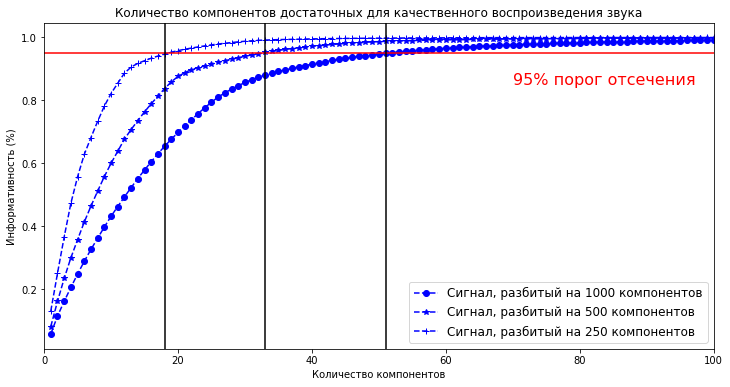

In [ ]:
plt.rcParams["figure.facecolor"] ='white'
plt.rcParams["figure.figsize"] = (12,6)

fig, ax = plt.subplots()
markers = ['o', '*', '+']

for i in range(len(rescaled_dict_matrix)):
  
  pca = PCA().fit(rescaled_dict_matrix[i])
  xi = np.arange(1, len(rescaled_dict_matrix[i][0]) + 1, step=1)
  y = np.cumsum(pca.explained_variance_ratio_)

  plt.plot(xi, y, marker=markers[i], linestyle='--', color='b')

plt.xlabel('Количество компонентов')
plt.ylabel('Информативность (%)')
plt.title('Количество компонентов достаточных для качественного воспроизведения звука')

plt.axhline(y=0.95, color='red', linestyle='-')
plt.axvline(x=51, color='black', linestyle='-')
plt.axvline(x=33, color='black', linestyle='-')
plt.axvline(x=18, color='black', linestyle='-')
plt.legend(['Cигнал, разбитый на 1000 компонентов', 'Cигнал, разбитый на 500 компонентов', 'Cигнал, разбитый на 250 компонентов'], fontsize=12)

plt.text(70, 0.85, '95% порог отсечения', color = 'red', fontsize=16)
plt.xlim([0, 100])

plt.show()

Таким образом, для сохранения 95% информации в звуковой дорожке, разбитой на 1000 компонентов достаточно всего 51 компонента.

4. (доп задание)

  a) Оберните получившийся код по сжатию звука в одну или несколько функций

  b) Проведите исследование того, как степень сжатия (соотношения размера частей, на которые делился сигнал в задании 1.1 к размеру пространсва, в которое вы сжимали данные с помощью PCA) влияет на звук, по субъективным ощущениям. Начиная с какой степени сжания сильно слышится потеря качества? (как с учетом фильтрации с помощью gaussian_filter1d, так и без неё)

  d) Что степень сжатия означает для PCA? Для большой аудиозаписи (3 мин, например) мы хотели бы разбить на большее, меньшее или такое же число отрезков как и для предложенной аудиозаписи? Почему?

  c) Можно ли как-то автоматически подобрать степерь сжатия? За что она отвечает в нашей задаче. Как степень сжатия влияет на звук? Почему она так влияет на звук? 



In [ ]:
params[0] = matrix_sound
params[1] = 51

In [ ]:
compression(*params, filter = True)

In [ ]:
params[1] = 0.95

In [ ]:
params[0] = rescaled_dict_matrix[0]
compression(*params, filter = True)

После преобразования данных появились шумы

In [ ]:
params[0] = rescaled_dict_matrix[1]
compression(*params, filter = True)

In [ ]:
params[0] = rescaled_dict_matrix[2]
compression(*params, filter = True)

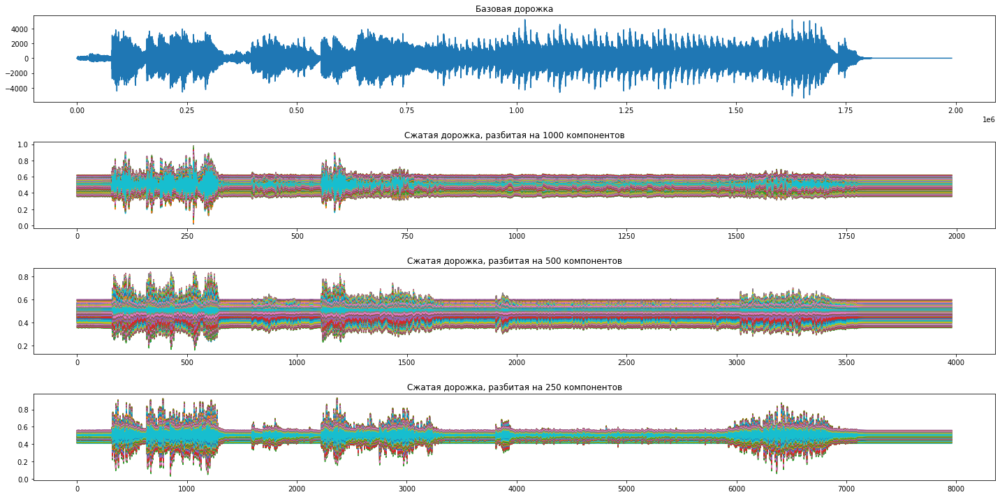

In [ ]:
params[1] = 1
plt.figure(figsize=(20,10), facecolor = 'white')

plt.subplot(4,1,1)
plt.plot(data[:,1])
plt.title('Базовая дорожка')

for i in range(len(rescaled_dict_matrix)):

  params[0] = rescaled_dict_matrix[i]
  plt.subplot(4,1,2 + i)
  plt.plot(compression(*params,True))
  plt.title('Сжатая дорожка, разбитая на %0.0f компонентов' % (len(compression(*params,True)[i])))

plt.tight_layout()
plt.show()

При этом если выкрутить параметр на 1, что по идее должно соответствовать 100%, то звуковая дорожка становится совсем плохого качества...

На бОльшую часть вопросов уже был дан ответ, отвечу на то, что не успели затронуть.

- Что степень сжатия означает для PCA? Для большой аудиозаписи (3 мин, например) мы хотели бы разбить на большее, меньшее или такое же число отрезков как и для предложенной аудиозаписи? Почему?

Степень сжатия означает, сколько главных компонент необходимо выделить для сжатия данных. Чем длиннее размер дорожки тем больше в нем будет значений, следовательно стоит разбивать на максимально возможное число компонентов. Чем меньше возьмем компонентов тем сильнее будут выражены шумы на звуковой дорожке.

-  Как степень сжатия влияет на звук? Почему она так влияет на звук?

Степень сжатия ухудшает звуковую дорожку, т.к. часть информации в процессе сжатия теряется.